# Audio Data Preparation

The audio data needs to be broken up into 30 milisecond windows and labeled by Vocal,Instrumental/noise, or silence.

In [2]:
import os
import IPython.display as ipd
from scipy.io import wavfile
import pandas as pd
from python_speech_features import mfcc, logfbank
import math
import pickle
import matplotlib.pyplot as plt
import numpy as np
from dask import dataframe as dd
from sklearn.cluster import KMeans

To nicely visualize and interact with the data, Each track will be represented as a Wav object containing the tracks sampling title, signal,label(vocal or noise), and it's Windowed representation. Each Wav object will contain a Window object which transforms the original signal into windows/chunks of the signal controlled by the windowSize parameter which will be important for analysis later. The sampling rate is normally 44100 samples per second

In [3]:
def getFFT(signal,rate):
    n = len(signal)
    #returns freq response, d is space between samples
    freq = np.fft.rfftfreq(n,d=1/rate)       
    #normalized magnitude response 
    Y = abs(np.fft.rfft(signal)/n) 
    return (Y,freq)

In [4]:
class Wav:
    #potentially add window_size here
    def __init__(self,title,rate,signal,label,windowSize=5):
        self.title = title
        self.rate = rate
        self.label = label
        self.signal = signal[:,0]
        self.Window = Window(windowSize=windowSize,rate=rate,title=title,signal=self.signal)
    def __str__(self):
        return str(self.title)
    def getDurationMinutes(self):
        return round(self.signal.shape[0]/self.rate / 60,2)
    def getDurationSeconds(self):
        return self.signal.shape[0]/self.rate

This function does some calculations to nicely transform the original signal into the windowed signal.

In [5]:
def windowSignal(signal,rate,windowSize):
    songSamples = len(signal)
    windowLength = int(windowSize * rate)
    windows = math.ceil(songSamples/windowLength)
    padding = np.zeros(windowLength*windows-len(signal))
    windowedSignal = np.concatenate((signal, padding), axis=0).reshape(windows,windowLength)
    return windowedSignal

Audio tracks of only vocals and instrumentals/noise have already been identified in the data collection step. To identify the silence in each track, the energy of each window/chunk is calculated and analyzed by kmeans clustering with an expected 2 clusters. This means each track has its own kmeans clustering which contains what is predicted to be a cluster of silence (window signals with low energy) and a cluster of the signal (window signals with high energy). The cluster with higher average energy contains the signal and the other contains low frequency noise/silence. This is essentially called noise floor detection or enveloping which is traditionally down with a low pass filter. Since the signals may vary a lot I used a kmeans classification instead. 

In [6]:
class Window:
    #potentially add window_size here
    def __init__(self,title,signal,rate,windowSize=5):
        self.title = title
        self.signal=signal
        self.rate = rate
        self.songSamples = len(signal)
        self.windowSize = windowSize
        self.windowedSignal = windowSignal(signal=signal,rate=rate,windowSize=windowSize)
        self.window_energy = np.sum(np.power(np.abs(self.windowedSignal),
                np.ones(self.windowedSignal.shape[0]).reshape(-1,1)),
       axis=1)
        #Classify silence based on window energy
        kmeans = KMeans(n_clusters=2, random_state=0).fit(self.window_energy.reshape(-1,1))
        self.labels = kmeans.labels_
        ave1 = np.average(self.window_energy[kmeans.labels_==0])
        ave2 = np.average(self.window_energy[kmeans.labels_==1])
        #if cluster 0 has lesser average energy then silence is cluster 0
        self.silence_label = int(ave1 > ave2) 
    def __str__(self):
        c = int(len(self.title)/3)
        return "windows:"+str(self.windowedSignal.shape[0])

Given a list of directories this function will grab all of the wavefiles in each and build the dataframe

In [7]:
#given list of dirs 
def getMetaData(dirs,windowSize):
    wavefiles = []
    windowedWaves = []
    for label in dirs:
        print("Reading tracks from",label)
        files = os.listdir(label)
        for fileName in files:
            #print(fileName)
            rate,signal = wavfile.read(label + "/" + fileName)
            track = Wav(title=fileName,
                          rate=rate,
                          signal=signal,
                          label=label.replace("audio/","").replace("Wav",""),
                          windowSize=windowSize#0.03 #change this parameter here for window size
                       )
            wavefiles.append(track)
            windowedWaves.append(track.Window)
    return wavefiles,windowedWaves

Seprate Vocal and Istrumental tracks have already been organized into directories

In [27]:
wavefiles,windowedWaves = getMetaData(['audio/vocalWav','audio/noiseWav'],2) #0.03
tracks_df = pd.DataFrame({'Wavefiles':wavefiles,'WindowedWaves':windowedWaves})
tracks_df['rate'] = tracks_df['Wavefiles'].apply(lambda x:x.rate)
tracks_df['durationMinutes'] = tracks_df['Wavefiles'].apply(lambda x:x.getDurationMinutes())
tracks_df['label'] = tracks_df['Wavefiles'].apply(lambda x:x.label)
tracks_df['samples'] = tracks_df['Wavefiles'].apply(lambda x:x.signal.shape[0])

Reading tracks from audio/vocalWav
Reading tracks from audio/noiseWav


In [28]:
tracks_df.head(5)

,Wavefiles,WindowedWaves,rate,durationMinutes,label,samples
0,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,windows:131,44100,4.35,vocal,11505664
1,Coldplay_Clocks_Studio_Acapella_DL_Link.wav,windows:126,44100,4.20,vocal,11108352
2,2Pac_Troublesome_Studio_Acapella_DL_Link.wav,windows:107,44100,3.53,vocal,9353216
3,Bruno_Mars_Locked_Out_of_Heaven_Studio_Acapell...,windows:115,44100,3.81,vocal,10079232
4,Avicii_Sandro_Cavazza_Without_You_Studio_Acape...,windows:66,44100,2.18,vocal,5779456


In [29]:
tracks_df.tail(5)

,Wavefiles,WindowedWaves,rate,durationMinutes,label,samples
27,illusions_Original_Mix.wav,windows:85,44100,2.82,noise,7453696
28,Idealism_-_Time_Will_Tell.wav,windows:85,44100,2.82,noise,7456768
29,cold_door_handles.wav,windows:74,44100,2.45,noise,6471680
30,midnight_somewhere.wav,windows:98,44100,3.25,noise,8596480
31,calm.wav,windows:62,44100,2.06,noise,5448704


Create a new dataframe of only windows with labels

In [30]:
window = []
windowid = []
def unzipWindow(row):
    row[1].windowedSignal
    #which classifier label represents silence
    silence = row[1].silence_label
    idx = np.arange(row[1].windowedSignal.shape[0])
    title = []
    #add each signal element to list
    title += [(row[0].title,row[0].label,idx[x],
               row[1].labels[x]==silence,
               row[1].windowedSignal[x]) for x in range(len(idx))]
    #len(idx),silence,
    return title

In [31]:
k = tracks_df.apply(lambda x : unzipWindow(x) ,axis=1)

In [32]:
flat_list = [item for sublist in k for item in sublist]

In [33]:
window_df = pd.DataFrame(flat_list, columns =['title', 'label','WindowIdx','Silence','windowedSignal'])

In [34]:
window_df.head()

,title,label,WindowIdx,Silence,windowedSignal
0,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,vocal,0,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,vocal,1,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,vocal,2,True,"[0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, -1.0, 0.0,..."
3,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,vocal,3,True,"[0.0, 1.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0,..."
4,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,vocal,4,True,"[-1.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0..."


new_frame_orig = window_df.groupby('title')['windowedSignal'].apply(np.hstack)

new_frame = window_df[window_df['Silence']==False].groupby('title')['windowedSignal'].apply(np.hstack)

ipd.Audio(new_frame[0], rate=44100)

ipd.Audio(new_frame_orig[0], rate=44100)

In [35]:
len(window_df)

6284

In [36]:
window_df.loc[window_df['Silence'] == True,'label']='silence'

In [37]:
window_df[window_df['title'] == 'midnight_somewhere.wav'].head(5)

,title,label,WindowIdx,Silence,windowedSignal
6124,midnight_somewhere.wav,silence,0,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
6125,midnight_somewhere.wav,silence,1,True,"[187.0, 125.0, 31.0, 152.0, 470.0, 546.0, 172...."
6126,midnight_somewhere.wav,silence,2,True,"[-786.0, -997.0, -1120.0, -965.0, -685.0, -536..."
6127,midnight_somewhere.wav,silence,3,True,"[-175.0, 212.0, 429.0, 821.0, 1347.0, 1795.0, ..."
6128,midnight_somewhere.wav,silence,4,True,"[487.0, 601.0, 670.0, 686.0, 671.0, 608.0, 491..."


In [56]:
df_test = window_df[window_df['Silence']==False].groupby('title')['windowedSignal'].apply(np.hstack)

In [48]:
df_test_orig = window_df.groupby('title')['windowedSignal'].apply(np.hstack)

In [49]:
df_test['midnight_somewhere.wav']

array([0., 0., 0., ..., 0., 0., 0.])

In [54]:
df_test

title
2Pac_Troublesome_Studio_Acapella_DL_Link.wav                          [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
Akon_Lonely_Studio_Acapella_DL_Link.wav                               [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
Alice_Deejay_Better_Off_Alone_Studio_Acapella_DL_Link.wav             [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
At_Cafe_lofi_jazz_hip_hop_mix.wav                                     [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
Avicii_Sandro_Cavazza_Without_You_Studio_Acapella_DL_Link.wav         [-482.0, -503.0, -501.0, -504.0, -508.0, -489....
Backstreet_Boys_I_Want_It_That_Way_Studio_Acapella_DL_Link.wav        [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
Bruno_Mars_Locked_Out_of_Heaven_Studio_Acapella_DL_Link.wav           [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
Coldplay_Clocks_Studio_Acapella_DL_Link.wav                           [2939.0, 2855.0, 2692.0, 2434.0, 2022.0, 1587....
Coldplay_Paradise_Studio_Acapella_

# Processed Track

In [57]:
ipd.Audio(df_test['2Pac_Troublesome_Studio_Acapella_DL_Link.wav'], rate=44100)

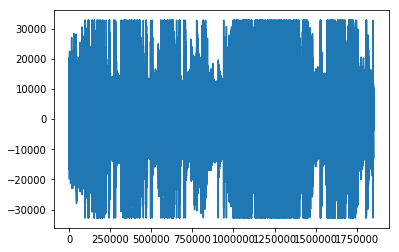

In [22]:
plt.plot(df_test['midnight_somewhere.wav'])

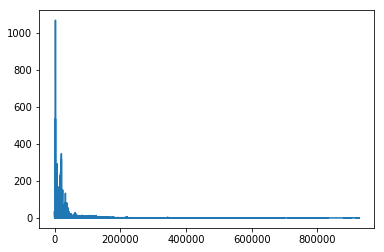

In [23]:
Y,rate = getFFT(df_test['midnight_somewhere.wav'],44100)
plt.plot(Y)

# Original Track

In [24]:
ipd.Audio(df_test_orig['midnight_somewhere.wav'], rate=44100)

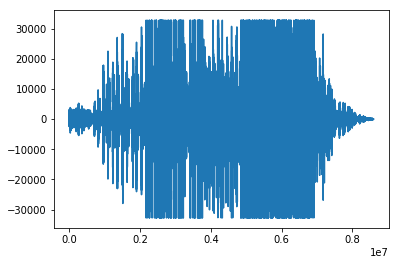

In [25]:
plt.plot(df_test_orig['midnight_somewhere.wav'])

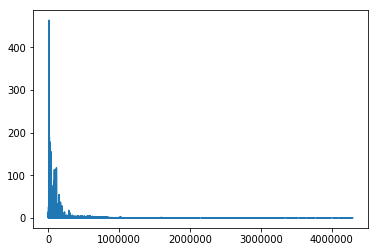

In [26]:
Y,rate = getFFT(df_test_orig['midnight_somewhere.wav'],44100)
plt.plot(Y)

In [27]:
mel = mfcc(df_test_orig['midnight_somewhere.wav'], 
           44100, numcep=13, nfilt=26, nfft=1323).T
bank = logfbank(df_test_orig['midnight_somewhere.wav'], 
                44100, nfilt=26, nfft=1323).T

To test if the data has been labeled correctly, the a new dataframe has been constructed where all the silient windows have been stripped. You can play the original track and processed track to hear that there is no silence in the processed track.

In [28]:
window_df.head()

,title,label,WindowIdx,Silence,windowedSignal
0,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,silence,0,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,silence,1,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,silence,2,True,"[0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1...."
3,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,silence,3,True,"[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, -1.0,..."
4,Rihanna_Kiss_It_Better_Studio_Acapella_DL_Link...,silence,4,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0..."


Compress and store data from dataframe. The columns have been saved separately since I had trouble saving the dateframe as a whole. This could because of the complex data types in the dataframe

In [51]:
window_df.title.to_hdf('window_title.hf5','window')
window_df.label.to_hdf('window_label.hf5','window')
window_df.WindowIdx.to_hdf('window_WindowIdx.hf5','window')
window_df.Silence.to_hdf('window_Silence.hf5','window')
window_df.windowedSignal.to_pickle('window_windowedSignal.pkl')